In [ ]:
import json
from transformers import AutoTokenizer, AutoModelForTokenClassification

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Function to load data from a .jsonl file
def load_data_from_jsonl(file_path):
    data = []
    with open(file_path, 'r') as file:
        for line in file:
            data.append(json.loads(line))
    return data


# Load the dataset
dataset = load_data_from_jsonl('/content/drive/My Drive/NLP project folder/mednli/mli_train_v1.jsonl')
print("First record in the dataset:", dataset[0])

First record in the dataset: {'sentence1': 'Labs were notable for Cr 1.7 (baseline 0.5 per old records) and lactate 2.4.', 'pairID': '23eb94b8-66c7-11e7-a8dc-f45c89b91419', 'sentence1_parse': '(ROOT (S (NP (NNPS Labs)) (VP (VBD were) (ADJP (JJ notable) (PP (IN for) (NP (NP (NP (NN Cr) (CD 1.7)) (PRN (-LRB- -LRB-) (NP (NP (NN baseline) (CD 0.5)) (PP (IN per) (NP (JJ old) (NNS records)))) (-RRB- -RRB-))) (CC and) (NP (NN lactate) (CD 2.4)))))) (. .)))', 'sentence1_binary_parse': '( Labs ( ( were ( notable ( for ( ( ( ( Cr 1.7 ) ( -LRB- ( ( ( baseline 0.5 ) ( per ( old records ) ) ) -RRB- ) ) ) and ) ( lactate 2.4 ) ) ) ) ) . ) )', 'sentence2': ' Patient has elevated Cr', 'sentence2_parse': '(ROOT (S (NP (NN Patient)) (VP (VBZ has) (NP (JJ elevated) (NN Cr)))))', 'sentence2_binary_parse': '( Patient ( has ( elevated Cr ) ) )', 'gold_label': 'entailment'}


In [ ]:
# Load BioBERT tokenizer and model
tokenizer = AutoTokenizer.from_pretrained("dmis-lab/biobert-v1.1")
model = AutoModelForTokenClassification.from_pretrained("dmis-lab/biobert-v1.1")

Some weights of BertForTokenClassification were not initialized from the model checkpoint at dmis-lab/biobert-v1.1 and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
# from transformers import AutoTokenizer, AutoModelForTokenClassification

# model_checkpoint = "dmis-lab/biobert-base-cased-v1.1-squad"
# tokenizer = AutoTokenizer.from_pretrained(model_checkpoint)
# model = AutoModelForTokenClassification.from_pretrained(model_checkpoint)

In [ ]:
# Process each record in the dataset
# Fine-tuned for NER
# Use the model to predict named entities
# The process for the first record
record = dataset[10]

input_sentence1 = tokenizer(record['sentence1'], return_tensors="pt")
outputs1 = model(**input_sentence1)
predictions1 = outputs1.logits.argmax(dim=2)
predictions1

tensor([[1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1,
         1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0,
         1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1]])

In [ ]:
input_sentence2 = tokenizer(record['sentence2'], return_tensors="pt")
outputs2 = model(**input_sentence2)
predictions2 = outputs2.logits.argmax(dim=2)
predictions2

tensor([[1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0]])

In [ ]:
print([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1].count(1))
print([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1].count(0))
24/29

24
5


0.8275862068965517

In [ ]:
s1_pred_acc = []
s2_pred_acc = []
for record in dataset:
  input_sentence1 = tokenizer(record['sentence1'], return_tensors="pt")
  outputs = model(**input_sentence1)
  predictions = outputs.logits.argmax(dim=2)
  s1_pred_acc.append(predictions.tolist()[0].count(1)/len(predictions.tolist()[0]))
  input_sentence2 = tokenizer(record['sentence2'], return_tensors="pt")
  outputs = model(**input_sentence2)
  predictions = outputs.logits.argmax(dim=2)
  s2_pred_acc.append(predictions.tolist()[0].count(1)/len(predictions.tolist()[0]))


In [ ]:
import numpy as np
print(np.mean(s1_pred_acc))
print(np.mean(s2_pred_acc))

0.7113996242175495
0.8839105158069023


In [ ]:
ss1_pred_acc = []
ss2_pred_acc = []
for record in dataset[:500]:
  input_sentence1 = tokenizer(record['sentence1'], return_tensors="pt")
  outputs = model(**input_sentence1)
  predictions = outputs.logits.argmax(dim=2)
  ss1_pred_acc.append(predictions.tolist()[0].count(1)/len(predictions.tolist()[0]))
  input_sentence2 = tokenizer(record['sentence2'], return_tensors="pt")
  outputs = model(**input_sentence2)
  predictions = outputs.logits.argmax(dim=2)
  ss2_pred_acc.append(predictions.tolist()[0].count(1)/len(predictions.tolist()[0]))


In [ ]:
print(np.mean(ss1_pred_acc))
print(np.mean(ss2_pred_acc))

0.6902373847231683
0.8975860307133527


In [ ]:
print(np.mean(ss1_pred_acc))
print(np.mean(ss2_pred_acc))

0.6945418205904202
0.8914779554810515


In [ ]:
def load_mednli_data(file_path):
    data = []
    with open(file_path, 'r') as file:
        for line in file:
            data.append(json.loads(line))
    print(data[:5])
    return data

train_path = '/content/drive/My Drive/NLP project folder/mednli/mli_train_v1.jsonl'
dev_path = '/content/drive/My Drive/NLP project folder/mednli/mli_dev_v1.jsonl'
test_path = '/content/drive/My Drive/NLP project folder/mednli/mli_test_v1.jsonl'

# Load the data
train_data = load_mednli_data(train_path)
dev_data = load_mednli_data(dev_path)
test_data = load_mednli_data(test_path)

[{'sentence1': 'Labs were notable for Cr 1.7 (baseline 0.5 per old records) and lactate 2.4.', 'pairID': '23eb94b8-66c7-11e7-a8dc-f45c89b91419', 'sentence1_parse': '(ROOT (S (NP (NNPS Labs)) (VP (VBD were) (ADJP (JJ notable) (PP (IN for) (NP (NP (NP (NN Cr) (CD 1.7)) (PRN (-LRB- -LRB-) (NP (NP (NN baseline) (CD 0.5)) (PP (IN per) (NP (JJ old) (NNS records)))) (-RRB- -RRB-))) (CC and) (NP (NN lactate) (CD 2.4)))))) (. .)))', 'sentence1_binary_parse': '( Labs ( ( were ( notable ( for ( ( ( ( Cr 1.7 ) ( -LRB- ( ( ( baseline 0.5 ) ( per ( old records ) ) ) -RRB- ) ) ) and ) ( lactate 2.4 ) ) ) ) ) . ) )', 'sentence2': ' Patient has elevated Cr', 'sentence2_parse': '(ROOT (S (NP (NN Patient)) (VP (VBZ has) (NP (JJ elevated) (NN Cr)))))', 'sentence2_binary_parse': '( Patient ( has ( elevated Cr ) ) )', 'gold_label': 'entailment'}, {'sentence1': 'Labs were notable for Cr 1.7 (baseline 0.5 per old records) and lactate 2.4.', 'pairID': '23eb979c-66c7-11e7-b76c-f45c89b91419', 'sentence1_parse': 

In [ ]:
from transformers import AutoTokenizer, AutoModelForTokenClassification
from transformers import pipeline

# Load BioBERT tokenizer and model
model_name = "dmis-lab/biobert-v1.1"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForTokenClassification.from_pretrained(model_name)

# Define NER pipeline
ner_pipeline = pipeline("ner", model=model, tokenizer=tokenizer)

Some weights of BertForTokenClassification were not initialized from the model checkpoint at dmis-lab/biobert-v1.1 and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
def extract_entities(data, ner_pipeline):
    entities = []
    for record in data:
        sentence1 = record['sentence1']  # Adjusted key
        sentence2 = record['sentence2']  # Adjusted key

        # Extract entities for each sentence
        sentence1_entities = ner_pipeline(sentence1)
        sentence2_entities = ner_pipeline(sentence2)

        entities.append({
            "sentence1_entities": sentence1_entities,
            "sentence2_entities": sentence2_entities
        })
    return entities

# Extract entities from the train dataset as an example
train_entities = extract_entities(train_data, ner_pipeline)

In [ ]:
train_entities

[{'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.5482457,
    'index': 1,
    'word': 'Labs',
    'start': 0,
    'end': 4},
   {'entity': 'LABEL_0',
    'score': 0.55706906,
    'index': 2,
    'word': 'were',
    'start': 5,
    'end': 9},
   {'entity': 'LABEL_0',
    'score': 0.5384441,
    'index': 3,
    'word': 'notable',
    'start': 10,
    'end': 17},
   {'entity': 'LABEL_1',
    'score': 0.5433017,
    'index': 4,
    'word': 'for',
    'start': 18,
    'end': 21},
   {'entity': 'LABEL_0',
    'score': 0.5869624,
    'index': 5,
    'word': 'C',
    'start': 22,
    'end': 23},
   {'entity': 'LABEL_1',
    'score': 0.50636643,
    'index': 6,
    'word': '##r',
    'start': 23,
    'end': 24},
   {'entity': 'LABEL_0',
    'score': 0.58981925,
    'index': 7,
    'word': '1',
    'start': 25,
    'end': 26},
   {'entity': 'LABEL_0',
    'score': 0.66548556,
    'index': 8,
    'word': '.',
    'start': 26,
    'end': 27},
   {'entity': 'LABEL_0',
    'score': 0.54

In [ ]:
dev_entities = extract_entities(dev_data, ner_pipeline)
test_entities = extract_entities(test_data, ner_pipeline)

In [ ]:
dev_entities

[{'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.5666098,
    'index': 1,
    'word': 'No',
    'start': 0,
    'end': 2},
   {'entity': 'LABEL_1',
    'score': 0.59380066,
    'index': 2,
    'word': 'history',
    'start': 3,
    'end': 10},
   {'entity': 'LABEL_1',
    'score': 0.5833781,
    'index': 3,
    'word': 'of',
    'start': 11,
    'end': 13},
   {'entity': 'LABEL_0',
    'score': 0.624512,
    'index': 4,
    'word': 'blood',
    'start': 14,
    'end': 19},
   {'entity': 'LABEL_0',
    'score': 0.51218706,
    'index': 5,
    'word': 'c',
    'start': 20,
    'end': 21},
   {'entity': 'LABEL_0',
    'score': 0.5320927,
    'index': 6,
    'word': '##lot',
    'start': 21,
    'end': 24},
   {'entity': 'LABEL_1',
    'score': 0.50433946,
    'index': 7,
    'word': '##s',
    'start': 24,
    'end': 25},
   {'entity': 'LABEL_0',
    'score': 0.5754132,
    'index': 8,
    'word': 'or',
    'start': 26,
    'end': 28},
   {'entity': 'LABEL_1',
    'score': 0.

In [ ]:
test_entities

[{'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.5212914,
    'index': 1,
    'word': 'In',
    'start': 0,
    'end': 2},
   {'entity': 'LABEL_1',
    'score': 0.5635543,
    'index': 2,
    'word': 'the',
    'start': 3,
    'end': 6},
   {'entity': 'LABEL_0',
    'score': 0.53387356,
    'index': 3,
    'word': 'E',
    'start': 7,
    'end': 8},
   {'entity': 'LABEL_0',
    'score': 0.5677576,
    'index': 4,
    'word': '##D',
    'start': 8,
    'end': 9},
   {'entity': 'LABEL_0',
    'score': 0.5650765,
    'index': 5,
    'word': ',',
    'start': 9,
    'end': 10},
   {'entity': 'LABEL_0',
    'score': 0.5504842,
    'index': 6,
    'word': 'initial',
    'start': 11,
    'end': 18},
   {'entity': 'LABEL_1',
    'score': 0.52604806,
    'index': 7,
    'word': 'V',
    'start': 19,
    'end': 20},
   {'entity': 'LABEL_0',
    'score': 0.59553283,
    'index': 8,
    'word': '##S',
    'start': 20,
    'end': 21},
   {'entity': 'LABEL_0',
    'score': 0.55114824,
 

In [ ]:
import numpy as np

def save_entities(entities, filename):
    def convert(o):
        if isinstance(o, np.float32):
            return float(o)
        raise TypeError

    with open(filename, 'w') as file:
        json.dump(entities, file, default=convert)

save_entities(train_entities, 'train_entities.json')
save_entities(dev_entities, 'dev_entities.json')
save_entities(test_entities, 'test_entities.json')

In [ ]:
def filter_entities_by_score(entity_data, score_threshold):
    # Filter entities in 'sentence1_entities'
    filtered_sentence1 = [entity for entity in entity_data['sentence1_entities']
                          if entity['score'] > score_threshold]

    # Filter entities in 'sentence2_entities'
    filtered_sentence2 = [entity for entity in entity_data['sentence2_entities']
                          if entity['score'] > score_threshold]

    return {
        'sentence1_entities': filtered_sentence1,
        'sentence2_entities': filtered_sentence2
    }

In [ ]:
# Loop through the entire train_entities list and filter
filtered_train_entities = [filter_entities_by_score(entry, 0.78) for entry in train_entities]

# Remove entries where both 'sentence1_entities' and 'sentence2_entities' are empty
filtered_train_entities = [entry for entry in filtered_train_entities if entry['sentence1_entities'] or entry['sentence2_entities']]

# Check if the filtered list is empty
if not filtered_train_entities:
    print("Nothing found")
filtered_train_entities

[{'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.7906175,
    'index': 6,
    'word': 'main',
    'start': 25,
    'end': 29}],
  'sentence2_entities': []},
 {'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.7906175,
    'index': 6,
    'word': 'main',
    'start': 25,
    'end': 29}],
  'sentence2_entities': []},
 {'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.7906175,
    'index': 6,
    'word': 'main',
    'start': 25,
    'end': 29}],
  'sentence2_entities': []},
 {'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.78576314,
    'index': 3,
    'word': '##TO',
    'start': 3,
    'end': 5}],
  'sentence2_entities': []},
 {'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.78576314,
    'index': 3,
    'word': '##TO',
    'start': 3,
    'end': 5}],
  'sentence2_entities': []},
 {'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.78576314,
    'index': 3,
    'word': '##TO',
    'start': 3,
    'end': 5}],
  'sentence2

In [ ]:
filtered_test_entities = [filter_entities_by_score(entry, 0.78) for entry in test_entities]
filtered_test_entities = [entry for entry in filtered_test_entities if entry['sentence1_entities'] or entry['sentence2_entities']]

if not filtered_test_entities:
    print("Nothing found")
filtered_test_entities

[{'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.7834591,
    'index': 55,
    'word': '##so',
    'start': 158,
    'end': 160}],
  'sentence2_entities': []},
 {'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.7834591,
    'index': 55,
    'word': '##so',
    'start': 158,
    'end': 160}],
  'sentence2_entities': []},
 {'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.7834591,
    'index': 55,
    'word': '##so',
    'start': 158,
    'end': 160}],
  'sentence2_entities': []}]

In [ ]:
filtered_dev_entities = [filter_entities_by_score(entry, 0.75) for entry in dev_entities]
filtered_dev_entities = [entry for entry in filtered_dev_entities if entry['sentence1_entities'] or entry['sentence2_entities']]

if not filtered_dev_entities:
    print("Nothing found")
filtered_dev_entities

[{'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.7611841,
    'index': 41,
    'word': '.',
    'start': 62,
    'end': 63}],
  'sentence2_entities': []},
 {'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.7611841,
    'index': 41,
    'word': '.',
    'start': 62,
    'end': 63}],
  'sentence2_entities': []},
 {'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.7611841,
    'index': 41,
    'word': '.',
    'start': 62,
    'end': 63}],
  'sentence2_entities': []},
 {'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.7695495,
    'index': 21,
    'word': 'last',
    'start': 63,
    'end': 67}],
  'sentence2_entities': []},
 {'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.7695495,
    'index': 21,
    'word': 'last',
    'start': 63,
    'end': 67}],
  'sentence2_entities': []},
 {'sentence1_entities': [{'entity': 'LABEL_0',
    'score': 0.7695495,
    'index': 21,
    'word': 'last',
    'start': 63,
    'end': 67}],
  'sentence2

In [ ]:
train_words_list = []
for entry in filtered_train_entities:
    train_words_list.extend([entity['word'] for entity in entry['sentence1_entities']])
    train_words_list.extend([entity['word'] for entity in entry['sentence2_entities']])
train_words_list

['main',
 'main',
 'main',
 '##TO',
 '##TO',
 '##TO',
 '##lo',
 '##lo',
 '##lo',
 '##TO',
 '##TO',
 '##TO',
 '##titis',
 '##titis',
 '##titis',
 '##nu',
 '##nu',
 '##nu',
 '##TO',
 '##TO',
 '##TO',
 '1798',
 '1798',
 '1798',
 'issue',
 '##pop',
 '##pop',
 '##pop',
 'way',
 'way',
 'way',
 '##lar',
 '##lar',
 '##lar',
 '##TO',
 '##TO',
 '##TO']

In [ ]:
test_words_list = []
for entry in filtered_test_entities:
    test_words_list.extend([entity['word'] for entity in entry['sentence1_entities']])
    test_words_list.extend([entity['word'] for entity in entry['sentence2_entities']])
test_words_list

['##so', '##so', '##so']

In [ ]:
dev_words_list = []
for entry in filtered_dev_entities:
    dev_words_list.extend([entity['word'] for entity in entry['sentence1_entities']])
    dev_words_list.extend([entity['word'] for entity in entry['sentence2_entities']])
dev_words_list

['.',
 '.',
 '.',
 'last',
 'last',
 'last',
 '##TO',
 '##TO',
 '##TO',
 '##asi',
 '##asi',
 '##asi',
 'main',
 'main',
 'main',
 '##mo',
 '##mo',
 '##mo',
 '##TO',
 '##TO',
 '##TO',
 '##ame',
 'oval',
 '##ame',
 'oval',
 '##ame',
 'oval',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 'therefore',
 'therefore',
 'therefore',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##amp',
 '##amp',
 '##amp',
 '##TO',
 '##TO',
 '##TO',
 '##mi',
 '##mi',
 '##mi',
 '##co',
 '##co',
 '##co',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##TO',
 '##i',
 '##i',
 '##i']

In [ ]:
filtered_train_entities = [filter_entities_by_score(entry, 0.7) for entry in train_entities]
filtered_train_entities = [entry for entry in filtered_train_entities if entry['sentence1_entities'] or entry['sentence2_entities']]
train_words_list = []
for entry in filtered_train_entities:
    train_words_list.extend([entity['word'] for entity in entry['sentence1_entities']])
    train_words_list.extend([entity['word'] for entity in entry['sentence2_entities']])
train_words_list = list(set(train_words_list))
train_words_list

['way',
 '##ities',
 '##uno',
 '*',
 'official',
 '##nio',
 '##c',
 '##no',
 'without',
 '##lav',
 '##tic',
 'bi',
 '##MA',
 'hearth',
 '##ores',
 '##ime',
 '##nu',
 'tube',
 'Note',
 'SV',
 'side',
 '##mo',
 'activities',
 'kidney',
 'MCA',
 '##e',
 '##yt',
 'ta',
 'ears',
 '##pal',
 '##th',
 '-',
 'section',
 '##titis',
 '##ami',
 '##bro',
 '##ole',
 '##omo',
 '##tro',
 '8',
 '4',
 'phone',
 'or',
 '##ino',
 '##cke',
 '##icus',
 'only',
 'chromosome',
 '##co',
 'to',
 '##lar',
 '##olar',
 'muscle',
 '##com',
 '##op',
 'tobacco',
 '##uc',
 '##spiration',
 'came',
 'name',
 '##oso',
 '2',
 'may',
 'improving',
 'often',
 'Title',
 '##llar',
 'block',
 '##cy',
 '##lat',
 '##ton',
 '130',
 'Came',
 'likely',
 '##Y',
 '##TO',
 '##lap',
 'made',
 'par',
 '##lo',
 'cancer',
 '##elo',
 '##ald',
 '##ilization',
 '5th',
 's',
 'he',
 '##igi',
 '##r',
 '##olio',
 '##am',
 'from',
 '##en',
 'dominant',
 'MR',
 'therefore',
 '##ogy',
 '##gill',
 '##asi',
 'pump',
 'most',
 '##omi',
 'Had',
 'birt

In [ ]:
def reconstruct_words(token_list):
    reconstructed_words = []
    current_word = ''

    for token in token_list:
        if token.startswith('##'):
            current_word += token[2:]  # Remove '##' and append
        else:
            if current_word:
                reconstructed_words.append(current_word)
                current_word = ''
            current_word = token

    if current_word:
        reconstructed_words.append(current_word)

    return reconstructed_words

reconstructed_train_words = reconstruct_words(train_words_list)
reconstructed_train_words

['wayitiesuno',
 '*',
 'officialniocno',
 'withoutlavtic',
 'biMA',
 'hearthoresimenu',
 'tube',
 'Note',
 'SV',
 'sidemo',
 'activities',
 'kidney',
 'MCAeyt',
 'ta',
 'earspalth',
 '-',
 'sectiontitisamibrooleomotro',
 '8',
 '4',
 'phone',
 'orinockeicus',
 'only',
 'chromosomeco',
 'tolarolar',
 'musclecomop',
 'tobaccoucspiration',
 'came',
 'nameoso',
 '2',
 'may',
 'improving',
 'often',
 'Titlellar',
 'blockcylatton',
 '130',
 'Came',
 'likelyYTOlap',
 'made',
 'parlo',
 'cancereloaldilization',
 '5th',
 's',
 'heigirolioam',
 'fromen',
 'dominant',
 'MR',
 'thereforeogygillasi',
 'pump',
 'mostomi',
 'Had',
 'birthrome',
 'aspect',
 'seat',
 'so',
 'endzodaieriformchoisER',
 'wife',
 'Firstndi5etaltamtorysochiarunyming',
 'nervousD',
 'smallhea',
 '1798ukeedbstas',
 'mid',
 'wlateiolilodi',
 'Rum',
 'calledmuloss',
 'hipila',
 'excellentivalli',
 '1',
 'home',
 'Llexpecolaterople',
 'mitee',
 'issue',
 'first2ereluxmatstate',
 'paralysis',
 'time',
 'minuteix',
 'did',
 'auto',

In [ ]:
import string

def filter_tokens(word_list):
    # Define a set of punctuation to remove
    punctuation = set(string.punctuation)

    # Define a set of common words (stop words) to remove, if needed
    # You can use a predefined list like from the NLTK library
    import nltk
    nltk.download('stopwords')
    from nltk.corpus import stopwords
    stop_words = set(stopwords.words('english'))

    # Filter out words that are punctuation or common words
    filtered_words = [word for word in word_list if word not in punctuation] # and word not in stop_words
    return filtered_words

# Apply this to your reconstructed_train_words
filtered_train_words = filter_tokens(reconstructed_train_words)
filtered_train_words

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


['wayitiesuno',
 'officialniocno',
 'withoutlavtic',
 'biMA',
 'hearthoresimenu',
 'tube',
 'Note',
 'SV',
 'sidemo',
 'activities',
 'kidney',
 'MCAeyt',
 'ta',
 'earspalth',
 'sectiontitisamibrooleomotro',
 '8',
 '4',
 'phone',
 'orinockeicus',
 'only',
 'chromosomeco',
 'tolarolar',
 'musclecomop',
 'tobaccoucspiration',
 'came',
 'nameoso',
 '2',
 'may',
 'improving',
 'often',
 'Titlellar',
 'blockcylatton',
 '130',
 'Came',
 'likelyYTOlap',
 'made',
 'parlo',
 'cancereloaldilization',
 '5th',
 's',
 'heigirolioam',
 'fromen',
 'dominant',
 'MR',
 'thereforeogygillasi',
 'pump',
 'mostomi',
 'Had',
 'birthrome',
 'aspect',
 'seat',
 'so',
 'endzodaieriformchoisER',
 'wife',
 'Firstndi5etaltamtorysochiarunyming',
 'nervousD',
 'smallhea',
 '1798ukeedbstas',
 'mid',
 'wlateiolilodi',
 'Rum',
 'calledmuloss',
 'hipila',
 'excellentivalli',
 '1',
 'home',
 'Llexpecolaterople',
 'mitee',
 'issue',
 'first2ereluxmatstate',
 'paralysis',
 'time',
 'minuteix',
 'did',
 'auto',
 'Mi',
 'ba

In [ ]:
import re

def reconstruct_subwords(token_list):
    reconstructed_words = []
    current_word = ''

    for token in token_list:
        # Check if the token is a subword
        if token.startswith('##'):
            current_word += token[2:]  # Remove '##' and append
        else:
            if current_word:  # If there's a current word built up
                reconstructed_words.append(current_word)
            current_word = token  # Start a new word

    # Append the last word if there's any
    if current_word:
        reconstructed_words.append(current_word)

    return reconstructed_words

reconstructed_train_words = reconstruct_subwords(filtered_train_words)
def is_valid_word(word):
    # Simple checks to determine if a word is likely to be valid
    return len(word) > 1 and re.match("^[A-Za-z0-9-]+$", word)

valid_words = [word for word in reconstructed_train_words if is_valid_word(word)]
valid_words

['wayitiesuno',
 'officialniocno',
 'withoutlavtic',
 'biMA',
 'hearthoresimenu',
 'tube',
 'Note',
 'SV',
 'sidemo',
 'activities',
 'kidney',
 'MCAeyt',
 'ta',
 'earspalth',
 'sectiontitisamibrooleomotro',
 'phone',
 'orinockeicus',
 'only',
 'chromosomeco',
 'tolarolar',
 'musclecomop',
 'tobaccoucspiration',
 'came',
 'nameoso',
 'may',
 'improving',
 'often',
 'Titlellar',
 'blockcylatton',
 '130',
 'Came',
 'likelyYTOlap',
 'made',
 'parlo',
 'cancereloaldilization',
 '5th',
 'heigirolioam',
 'fromen',
 'dominant',
 'MR',
 'thereforeogygillasi',
 'pump',
 'mostomi',
 'Had',
 'birthrome',
 'aspect',
 'seat',
 'so',
 'endzodaieriformchoisER',
 'wife',
 'Firstndi5etaltamtorysochiarunyming',
 'nervousD',
 'smallhea',
 '1798ukeedbstas',
 'mid',
 'wlateiolilodi',
 'Rum',
 'calledmuloss',
 'hipila',
 'excellentivalli',
 'home',
 'Llexpecolaterople',
 'mitee',
 'issue',
 'first2ereluxmatstate',
 'paralysis',
 'time',
 'minuteix',
 'did',
 'auto',
 'Mi',
 'bar',
 'chronic',
 'flankemih',


In [ ]:
!pip install sentence_transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 kB 1.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 24.3 MB/s eta 0:00:00
  Created wheel for sentence_transformers: filename=sentence_transformers-2.2.2-py3-none-any.whl size=125923 sha256=e7489bc271ec5a113a2ab20627459c821d590bcf177b2cc1f77ee87fa1de400e
  Stored in directory: /root/.cache/pip/wheels/62/f2/10/1e606fd5f02395388f74e7462910fe851042f97238cbbd902f
Successfully built sentence_transformers


In [ ]:
from sentence_transformers import SentenceTransformer
import matplotlib.pyplot as plt
from scipy.spatial.distance import cosine

# Load a pre-trained sentence-transformer model
model = SentenceTransformer('sentence-transformers/all-mpnet-base-v2')

# Function to compute semantic similarity
def semantic_similarity(sentence1, sentence2):
    # Generate embeddings
    embeddings = model.encode([sentence1, sentence2])
    # Compute cosine similarity
    return 1 - cosine(embeddings[0], embeddings[1])


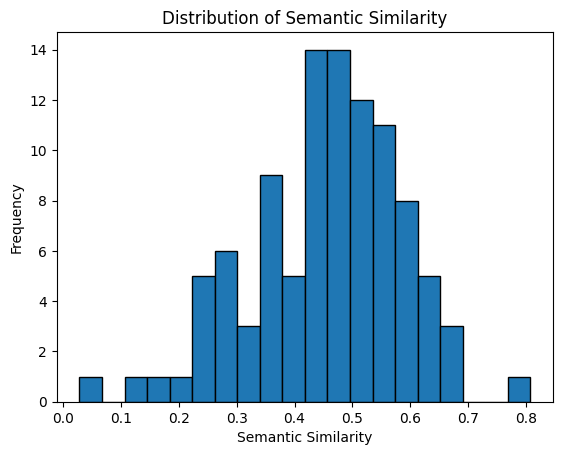

In [ ]:
# Compute semantic similarity for each record
similarities = [semantic_similarity(record['sentence1'], record['sentence2']) for record in dataset[:50]]

# Plot the histogram of similarities
plt.hist(similarities, bins=40, edgecolor='black')
plt.title('Distribution of Semantic Similarities')
plt.xlabel('Semantic Similarity')
plt.ylabel('Frequency')
plt.show()

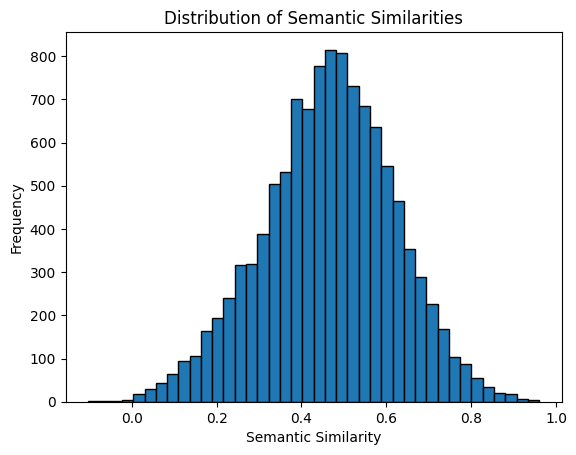

In [ ]:
# Compute semantic similarity for each record
similarities = [semantic_similarity(record['sentence1'], record['sentence2']) for record in dataset]

# Plot the histogram of similarities
plt.hist(similarities, bins=40, edgecolor='black')
plt.title('Distribution of Semantic Similarities')
plt.xlabel('Semantic Similarity')
plt.ylabel('Frequency')
plt.show()

In [ ]:
similarities

[0.5338866114616394,
 0.4905160665512085,
 0.31106865406036377,
 0.508658230304718,
 0.3703770637512207,
 0.2966357469558716,
 0.5219566226005554,
 0.4305002689361572,
 0.5435633063316345,
 0.6133223176002502,
 0.4279489815235138,
 0.5326308012008667,
 0.4937605559825897,
 0.4610069692134857,
 0.18256022036075592,
 0.5485007166862488,
 0.44085684418678284,
 0.41112223267555237,
 0.5059917569160461,
 0.522765576839447,
 0.3612646460533142,
 0.5837069153785706,
 0.5220680832862854,
 0.4573352634906769,
 0.6347234845161438,
 0.49292102456092834,
 0.45081329345703125,
 0.4807012379169464,
 0.45458829402923584,
 0.36799928545951843,
 0.37214982509613037,
 0.2336769700050354,
 0.2628958821296692,
 0.46710383892059326,
 0.4503806531429291,
 0.22958248853683472,
 0.3123193681240082,
 0.2064935863018036,
 0.2687934339046478,
 0.8079375624656677,
 0.5774768590927124,
 0.3283170163631439,
 0.5132201313972473,
 0.46545010805130005,
 0.36228373646736145,
 0.42586204409599304,
 0.2450874298810959,
 